In [1]:
from prody import *
from pylab import *
import MDAnalysis as mda
import nglview as nv
import mdtraj
from nglview.datafiles import PDB, XTC
from nglview.player import TrajectoryPlayer
from threading import Timer
import math
from scipy.linalg import fractional_matrix_power

In [2]:
pdb = '/srv/antibody/akshay_to_aarti/2FJG_fv.pdb'
structure = parsePDB(pdb)
structure

@> 1733 atoms and 1 coordinate set(s) were parsed in 0.02s.


<AtomGroup: 2FJG_fv (1733 atoms)>

@> 1733 atoms and 1 coordinate set(s) were parsed in 0.01s.


<Axes3D:xlabel='x', ylabel='y'>

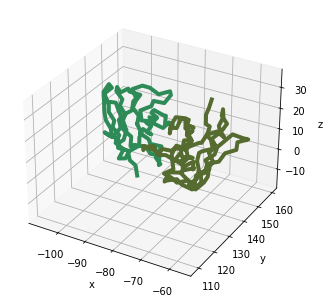

In [3]:
prot = prody.parsePDB(pdb)
%matplotlib inline
prody.showProtein(prot)

# Define a reference state of protein structure

In [4]:
widget = nv.show_mdtraj(mdtraj.load(pdb))
p = TrajectoryPlayer(widget)
#widget.add_ball_and_stick()
p.spin = True
def stop_spin():
    p.spin = False
    widget.close()
Timer(300, stop_spin).start()
widget

NGLWidget()

In [5]:
hv = structure.getHierView()
for chain in hv:
    print(chain)
ch_L = hv['L']
list_of_res = list(ch_L)
print(len(list(ch_L)))
ch_H = hv['H']
list_of_res = list(ch_H)
print(len(list(ch_H)))

Chain L
Chain H
107
120


In [6]:
lst = list(ch_L)
get_res = []
get_ind = []
CA_coord = []
for i in range(1, len(lst)+1):
    res = ch_L.getResidue(i)
    ind = res['CA']
    if ind != None:
        index_CA = ind.getIndex()
        coord = ind.getCoords()
        CA_coord.append(coord)
        get_ind.append(index_CA)
        get_res.append(res)
    else:
        print(res)

In [7]:
lst = list(ch_H)
for i in range(1, len(lst)+1):
    res = ch_H.getResidue(i)
    ind = res['CA']
    if ind != None:
        index_CA = ind.getIndex()
        coord = ind.getCoords()
        CA_coord.append(coord)
        get_ind.append(index_CA)
        get_res.append(res)
    else:
        print(res)

In [8]:
n = len(CA_coord)
x = 0
y = 0
z = 0
X1 = []
Y1 = []
Z1 = []
for i in range(n):
    x = x + CA_coord[i][0]
    X1.append(CA_coord[i][0])
    y = y + CA_coord[i][1]
    Y1.append(CA_coord[i][1])
    z = z + CA_coord[i][2]
    Z1.append(CA_coord[i][2])
x_ref = x/n
y_ref = y/n
z_ref = z/n
print(x_ref, y_ref, z_ref)

-79.19261674008813 136.2317224669603 13.569612334801766


# Hessian Matrix

In [9]:
Selection_a=1; #Use 0 for all-atomic NMA and 1 for C_alpha based NMA
Rc = 10
nbr = [[0 for _ in range(n)] for _ in range(n)]
K = [[0 for _ in range(n)] for _ in range(n)]
m = 3*n 
for i in range(n):
    for j in range(n):
        value = math.sqrt(pow((X1[i]-X1[j]), 2)+pow((Y1[i]-Y1[j]), 2)+pow((Z1[i]-Z1[j]), 2))
        #print(value)
        if j!=i and value < Rc:
            #print(value)
            nbr[i][j] = 1
            K[i][j] = 1

In [36]:
calphas = structure.select('protein and name CA')
anm = ANM('structure ANM analyis')
anm.buildHessian(calphas, cutoff=16.0, gamma=500.0)
H = anm.getHessian().round(3)
H

@> Hessian was built in 0.08s.


array([[ 4041.333,   446.156, -1384.078, ...,     0.   ,     0.   ,
            0.   ],
       [  446.156,  6514.998,  2208.885, ...,     0.   ,     0.   ,
            0.   ],
       [-1384.078,  2208.885,  5943.669, ...,     0.   ,     0.   ,
            0.   ],
       ...,
       [    0.   ,     0.   ,     0.   , ...,  2384.604,  -961.636,
         1396.997],
       [    0.   ,     0.   ,     0.   , ...,  -961.636,  2776.403,
        -2267.265],
       [    0.   ,     0.   ,     0.   , ...,  1396.997, -2267.265,
         6838.993]])

In [37]:
def get_residue_mass(x):
    aa1  = str('ALA')
    aa2  = str('ARG')
    aa3  = str('ASN')
    aa4  = str('ASP')
    aa5  = str('CYS')
    aa6  = str('GLU')
    aa7  = str('GLN')
    aa8  = str('GLY')
    aa9  = str('HIS')
    aa10 = str('ILE')
    aa11 = str('LEU')
    aa12 = str('LYS')
    aa13 = str('MET')
    aa14 = str('PHE')
    aa15 = str('PRO')
    aa16 = str('SER')
    aa17 = str('THR')
    aa18 = str('TRP')
    aa19 = str('TYR')
    aa20 = str('VAL')
    aa21 = str('SME')
    xr = x[0:3]
    y = 0
    if xr == aa1:
        y = 0.71
    elif xr == aa2:
        y = 1.56
    elif xr == aa3:
        y = 1.14
    elif xr == aa4:
        y = 1.15
    elif xr == aa5:
        y = 1.03
    elif xr == aa6:
        y = 1.29
    elif xr == aa7:
        y = 1.28
    elif xr == aa8:
        y = 0.57
    elif xr == aa9:
        y = 1.37
    elif xr == aa10:
        y = 1.13
    elif xr == aa11:
        y = 1.13
    elif xr == aa12:
        y = 1.28
    elif xr == aa13:
        y = 1.31
    elif xr == aa14:
        y = 1.47
    elif xr == aa15:
        y = 0.97
    elif xr == aa16:
        y = 0.87
    elif xr == aa17:
        y = 1.01
    elif xr == aa18:
        y = 1.86
    elif xr == aa19:
        y = 1.63
    elif xr == aa20:
        y = 0.99
    elif xr == aa21:
        y = 1.31
    return y

In [38]:
# Obtaining mass-weighted hessian matrix
#sum(get_res[i].getMasses())/len(get_res[0].getMasses())
m = 3*n
M = [[0 for _ in range(m)] for _ in range(m)]
for i in range(len(get_res)):
    #M[3*i][3*i] = sum(get_res[i].getMasses())
    #M[3*i+1][3*i+1] = sum(get_res[i].getMasses())
    #M[3*i+2][3*i+2] = sum(get_res[i].getMasses())
    M[3*i][3*i] = get_residue_mass(get_res[i].getResname())
    M[3*i+1][3*i+1] = get_residue_mass(get_res[i].getResname())
    M[3*i+2][3*i+2] = get_residue_mass(get_res[i].getResname())
mm = fractional_matrix_power(M, -0.5)
H_m = np.matmul(np.matmul(mm, H), mm)
H_m

array([[ 3514.2026087 ,   387.96173913, -1203.54608696, ...,
            0.        ,     0.        ,     0.        ],
       [  387.96173913,  5665.21565217,  1920.76956522, ...,
            0.        ,     0.        ,     0.        ],
       [-1203.54608696,  1920.76956522,  5168.40782609, ...,
            0.        ,     0.        ,     0.        ],
       ...,
       [    0.        ,     0.        ,     0.        , ...,
         2740.92413793, -1105.32873563,  1605.74367816],
       [    0.        ,     0.        ,     0.        , ...,
        -1105.32873563,  3191.26781609, -2606.05172414],
       [    0.        ,     0.        ,     0.        , ...,
         1605.74367816, -2606.05172414,  7860.91149425]])

In [39]:
anm = ANM('Using external Hessian')
anm.setHessian(H_m)
anm.calcModes(681, zeros = True)

@> WARNING Fewer than 6 (3) zero eigenvalues were calculated.
@> 681 modes were calculated in 0.08s.


In [51]:
anm.getModel()

<ANM: Using external Hessian (681 modes; 227 nodes)>

In [15]:
EV = anm.getEigvals().round(3)

In [16]:
EVec = anm.getEigvecs().round(3)

In [37]:
[EV, EVec] = np.linalg.eig(H_m)

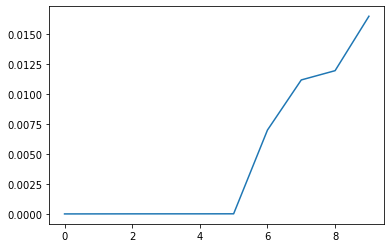

In [16]:
import matplotlib.pyplot as plt
plt.plot(np.sort(EV)[:10])

In [21]:
#[EV1, index] = np.diagonal(EV).copy().sort(), [i[0] for i in sorted(enumerate(np.diagonal(EV)), key=lambda x:x[1])]
#[EV1, index] = [i[1] for i in sorted(enumerate(np.diagonal(EV)), key=lambda x:x[1])], [i[0] for i in sorted(enumerate(np.diagonal(EV)), key=lambda x:x[1])]
[EV1, index] = [i[1] for i in sorted((enumerate(EV)), key=lambda x:x[1])], [i[0] for i in sorted((enumerate(EV)), key=lambda x:x[1])]

In [27]:
EV1 = [abs(x) for x in EV1]

In [28]:
EVec1 = []
for i in index:
    EVec1.append(EVec[i])
EVec1

[array([ 1.23359444e-03,  1.45321885e-03, -3.28318132e-04, -4.84377544e-04,
        -1.51144741e-04, -8.15797594e-04, -5.20988926e-04, -6.19636416e-04,
         8.36739068e-04,  6.96721504e-04, -1.88425511e-03,  3.13367464e-03,
        -4.85498880e-03,  1.15180789e-03,  8.78383920e-04,  1.78231526e-03,
        -1.10594661e-03, -1.47211707e-03, -5.47077374e-03, -6.94492925e-04,
        -2.03509412e-03, -5.60951547e-03, -4.16570061e-03, -1.16612531e-02,
         1.21912988e-03, -1.44210572e-03, -3.21098394e-03, -2.27468166e-03,
         3.41813825e-03, -2.11290145e-03, -7.75850037e-03, -8.98321437e-03,
         1.34701556e-02,  4.43263228e-03,  3.38529202e-03, -9.30319649e-03,
         2.49645406e-03,  1.22982142e-03, -6.14882492e-04,  3.03749672e-03,
         4.79809555e-03,  1.12783945e-01, -4.70331121e-02, -8.71723022e-02,
        -3.99321267e-02, -7.64631894e-02, -3.97958752e-02,  3.67276651e-02,
         6.05328711e-02,  4.33804451e-02, -4.30566890e-03,  2.57244035e-03,
        -2.3

In [17]:
C = anm.getCovariance().round(3)
C

array([[151.186,   7.402,  68.994, ..., -18.393, -61.884, -48.12 ],
       [  7.402,   5.933,  -0.449, ...,   2.414,   5.567,  -0.255],
       [ 68.994,  -0.449,  48.172, ..., -22.181, -56.089, -42.118],
       ...,
       [-18.393,   2.414, -22.181, ...,  13.635,  30.611,  22.429],
       [-61.884,   5.567, -56.089, ...,  30.611,  72.849,  52.153],
       [-48.12 ,  -0.255, -42.118, ...,  22.429,  52.153,  41.026]])

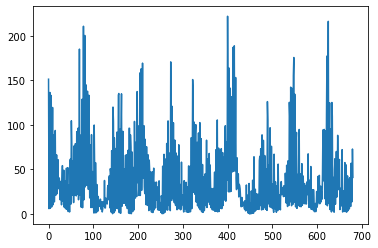

In [18]:
plt.plot(np.diagonal(C))

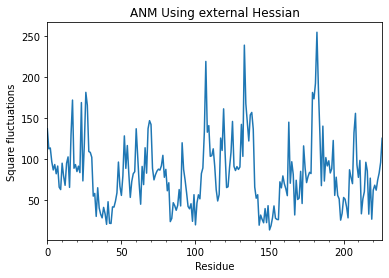

In [40]:
F = showSqFlucts(anm)

In [41]:
F = calcSqFlucts(anm)

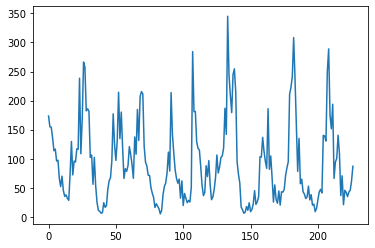

In [25]:
plt.plot(fluctuations)

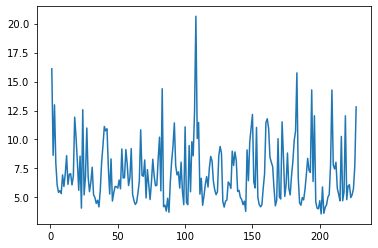

In [44]:
chL = 'rmsf_chL1000.xvg'
chH = 'rmsf_chH1000.xvg'

X = []
for i in range(1, 228):
    X.append(i)
Y = []    
for line in open(chL, 'r'):
    values = [float(s) for s in line.split()]
    Y.append(100*values[1])
for line in open(chH, 'r'):
    values = [float(s) for s in line.split()]
    Y.append(100*values[1])

#plt.plot(fluctuations)
plt.plot(X, Y)

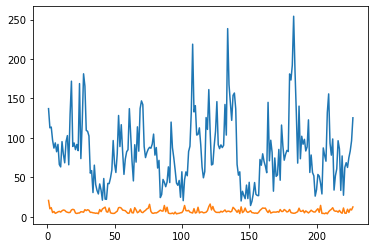

In [43]:
plt.plot(X, F)
plt.plot(X, Y) 
#8 loops supposed to be more flexible, hence 8 higher peaks

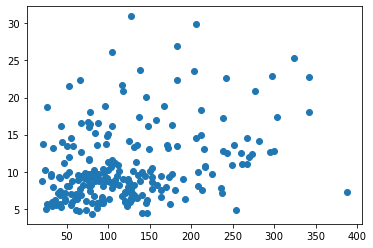

In [23]:
plt.scatter(F, Y)

@> Hessian was built in 0.02s.
@> WARNING Fewer than 6 (4) zero eigenvalues were calculated.
@> 681 modes were calculated in 0.06s.
@> Hessian was built in 0.03s.
@> WARNING Fewer than 6 (4) zero eigenvalues were calculated.
@> 681 modes were calculated in 0.07s.
@> Hessian was built in 0.04s.
@> WARNING Fewer than 6 (4) zero eigenvalues were calculated.
@> 681 modes were calculated in 0.07s.
@> Hessian was built in 0.05s.
@> WARNING Fewer than 6 (4) zero eigenvalues were calculated.
@> 681 modes were calculated in 0.07s.
@> Hessian was built in 0.05s.
@> WARNING Fewer than 6 (5) zero eigenvalues were calculated.
@> 681 modes were calculated in 0.08s.
@> Hessian was built in 0.06s.
@> WARNING Fewer than 6 (3) zero eigenvalues were calculated.
@> 681 modes were calculated in 0.08s.
@> Hessian was built in 0.07s.
@> WARNING Fewer than 6 (3) zero eigenvalues were calculated.
@> 681 modes were calculated in 0.08s.
@> Hessian was built in 0.08s.
@> WARNING Fewer than 6 (3) zero eigenvalues 

[0.14458958698504126, 0.12479142582387076, 0.15577824201154145, 0.15921044039787813, 0.17625201428761667, 0.267108672252343, 0.27102511394239703, 0.25257013188643596, 0.32060700548789356, 0.23385505784414395, 0.1622420923352052, 0.1905874593619049, 0.2853674077406824]


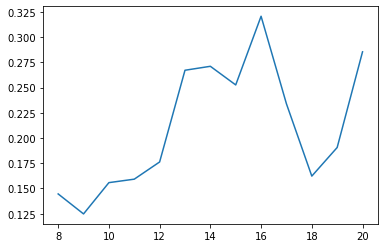

In [52]:
from scipy.stats import pearsonr

#R = [8, 9, 10, 11, 12, 13, 14, 15, 16, 17, 18, 19, 20]
R = range(8, 21)
#R = [21, 22, 23, 24, 25]
P = []
for i in R:
    calphas = structure.select('protein and name CA')
    anm = ANM('structure ANM analyis')
    anm.buildHessian(calphas, cutoff=i, gamma=500.0)
    H = anm.getHessian().round(3)
    m = 3*n
    M = [[0 for _ in range(m)] for _ in range(m)]
    for i in range(len(get_res)):
        M[3*i][3*i] = get_residue_mass(get_res[i].getResname())
        M[3*i+1][3*i+1] = get_residue_mass(get_res[i].getResname())
        M[3*i+2][3*i+2] = get_residue_mass(get_res[i].getResname())
        mm = fractional_matrix_power(M, -0.5)
    H_m = np.matmul(np.matmul(mm, H), mm)

    anm = ANM('Using external Hessian')
    anm.setHessian(H)
    anm.calcModes(681, zeros = True)
    F = calcSqFlucts(anm)
    corr, _ = pearsonr(Y, F)
    P.append(corr)
print(P)
plt.plot(R, P)

In [88]:
C = [[0 for _ in range(m)] for _ in range(m)]
#fluctuations = [0 for _ in range(n)] #estimated residue fluctuations
for i in range(6, m):
    C[i][i] = C[i][i] + (1/(EV[i]))*(np.matmul(EVec[i], np.transpose(EVec[i])))
    #C = C + (1/(EV1[i]))*(np.matmul(EVec1[i], np.transpose(EVec1[i])))
C

[[0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,


In [89]:
fluctuations = [0 for _ in range(n)] #estimated residue fluctuations
for i in range(n):
    fluctuations[i]=(C[3*i][3*i]+C[3*i+1][3*i+1]+C[3*i+2][3*i+2])
#fluctuations

In [24]:
C = np.linalg.inv(H_m)
fluctuations = [0 for _ in range(n)] #estimated residue fluctuations
for i in range(n):
    fluctuations[i]=(C[3*i][3*i]+C[3*i+1][3*i+1]+C[3*i+2][3*i+2])

In [105]:
#C = 2.47*np.linalg.inv(H_m)
#fluctuations = [0 for _ in range(n)]
#for i in range(n):
#    fluctuations[i] = abs(C[i][i])**0.5
#fluctuations

[99.63934494251933,
 47.817322160972076,
 120.41722047945339,
 95.99545479745012,
 44.27992947216444,
 112.61853984355214,
 101.58093333722212,
 62.79340156352485,
 122.39436997155751,
 101.10446275407655,
 64.25660741307333,
 116.35876210021311,
 88.13984462621742,
 70.06322457879301,
 109.43121888282825,
 97.10798137147897,
 80.83454455291458,
 110.62522904609858,
 80.85001419733123,
 75.56436142461358,
 98.76943806017731,
 82.2472586715445,
 86.86538860700823,
 95.59000911717973,
 76.2610523371269,
 84.15495647234845,
 76.92590152663617,
 73.81203418244118,
 87.44462293368937,
 56.400773781948324,
 80.98483157628421,
 100.06209332578246,
 53.99707469594752,
 69.63944489525767,
 93.0918084975192,
 25.005931945650236,
 61.55710934674379,
 77.28211182751308,
 29.26137355237569,
 65.00699020050287,
 85.79063679030384,
 62.01076278826842,
 64.26608877670316,
 75.92961182787664,
 80.02302385520788,
 52.867664053275604,
 47.38111742520809,
 49.49864591314271,
 81.95164941882473,
 76.907173

In [31]:
#EV_open = list(map(abs, EV1))
#NM_open = []
#for i in index:
#    NM_open.append(NM1[i])

In [55]:
#m = 3*n
#C = [[0 for _ in range(m)] for _ in range(m)]
#fluctuations = [0 for _ in range(n)]
#for i in range(6, m):
#    C[i][i] = C[i][i] + (1/(EV1[i]))*(NM_open[i]*np.transpose(NM_open[i]))
#C

In [32]:
#EV[1]

In [33]:
#m = 3*n
#C = [[0 for _ in range(m)] for _ in range(m)]
#fluctuations = [0 for _ in range(n)]
#for i in range(6, m):
    #C[i][i] = C[i][i] + (1/(EV[i]))*(NM1[i]*np.transpose(NM1[i]))
#    C[i][i] = (1/(NM1[i]))*(np.matmul(EV[i], np.transpose(EV[i])))
#C

[[0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,


In [39]:
#m = 3*n
#C = [[0 for _ in range(m)] for _ in range(m)]
#fluctuations = [0 for _ in range(n)]
#for i in range(m):
#    C[i][i] = (1/(EV1[i]))*(NM_open[i]*np.transpose(NM_open[i]))
#    C[i][i] = C[i][i].trace()
#C

In [44]:
fluctuations = list(map(abs, fluctuations))
fluctuations

[2.6453001645351675,
 3.9469484396655705,
 3.073515137516489,
 3.998244277418975,
 2.211701621531529,
 8.894290183296201,
 9.097978984867472,
 14.613705367873902,
 6.985803650161944,
 4.577972071211933,
 10.905349956193378,
 6.328471400754106,
 16.926291193443358,
 15.376512722107202,
 16.608351389035725,
 16.424796792497254,
 6.792685422562073,
 8.140325730633577,
 22.26440959315115,
 12.519735486929319,
 7.1227202043327384,
 10.123242768403136,
 11.591690195429319,
 28.421213881021853,
 24.957599625099302,
 48.745800015839365,
 39.07407994451916,
 17.034982107462845,
 11.62936674012569,
 19.18011685528196,
 43.98951362990013,
 39.30393549497276,
 26.144640861426936,
 37.811265362050946,
 24.046118431703174,
 47.169507152246574,
 53.511178102384555,
 30.262862712522953,
 16.024077466475205,
 32.20440891257536,
 13.390605493707673,
 77.37664671519569,
 23.0383626239286,
 28.312000460849497,
 17.089527833685032,
 52.69785019847898,
 63.872323631865505,
 39.40697907815105,
 53.9165785299

In [33]:
slowest_mode = NM_open[0]
index

[410,
 537,
 342,
 218,
 650,
 525,
 479,
 585,
 634,
 221,
 564,
 49,
 567,
 361,
 237,
 186,
 264,
 633,
 216,
 532,
 434,
 334,
 667,
 72,
 194,
 409,
 81,
 408,
 316,
 654,
 312,
 428,
 267,
 83,
 589,
 678,
 46,
 63,
 622,
 614,
 635,
 172,
 251,
 195,
 274,
 129,
 559,
 627,
 604,
 156,
 605,
 198,
 44,
 289,
 128,
 411,
 217,
 561,
 225,
 161,
 87,
 528,
 645,
 426,
 245,
 433,
 308,
 492,
 649,
 531,
 73,
 584,
 348,
 460,
 122,
 258,
 54,
 139,
 60,
 655,
 260,
 393,
 461,
 248,
 239,
 369,
 157,
 619,
 660,
 432,
 286,
 117,
 339,
 288,
 374,
 196,
 324,
 158,
 261,
 238,
 454,
 76,
 84,
 516,
 250,
 624,
 606,
 58,
 177,
 602,
 111,
 179,
 617,
 540,
 670,
 91,
 550,
 671,
 435,
 332,
 203,
 623,
 483,
 33,
 118,
 213,
 233,
 243,
 86,
 306,
 509,
 396,
 214,
 269,
 502,
 302,
 673,
 174,
 200,
 65,
 290,
 331,
 293,
 197,
 397,
 336,
 318,
 252,
 503,
 607,
 618,
 126,
 498,
 296,
 346,
 187,
 643,
 536,
 168,
 375,
 52,
 495,
 401,
 276,
 79,
 56,
 664,
 152,
 208,
 524,
 

In [34]:
x = []
for i in range(0, 100):
    x.append(i)

Text(0, 0.5, 'EigVec')

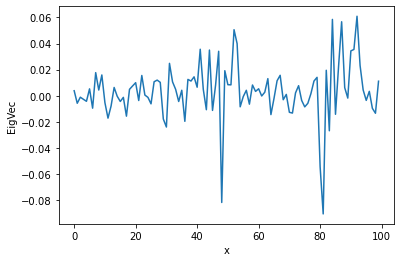

In [35]:
import matplotlib.pyplot as plt
plt.plot(x, EV[410][:100])
plt.xlabel('x')
plt.ylabel('EigVec')

In [36]:
x = []
for i in range(0, 100):
    x.append(i)

Text(0, 0.5, 'Fluctuations')

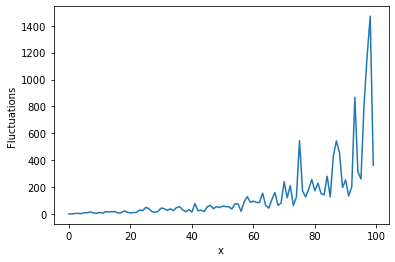

In [37]:
plt.plot(x, fluctuations[:100])
plt.xlabel('x')
plt.ylabel('Fluctuations')

In [38]:
import py3Dmol
anm, sel = prody.calcANM(prot)

@> Hessian was built in 0.06s.
@> 20 modes were calculated in 0.03s.


In [39]:
prody.showProtein(prot,vecs=anm[0].getArray(), flucts=prody.calcSqFlucts(anm[0]))

You appear to be running in JupyterLab (or JavaScript failed to load for some other reason). You need to install the 3dmol extension: 
 jupyter labextension install jupyterlab_3dmol

In [40]:
shape(anm[0].getArray())

(681,)

In [2]:
#fluctution
#LD
#excitation